In [56]:
import os
import scanpy as sc
import numpy as np
import pandas as pd
import faiss

import matplotlib.pyplot as plt
from matplotlib_venn import venn2
import seaborn as sns

import scSLAT
from scSLAT.model import Cal_Spatial_Net, load_anndatas, run_SLAT, spatial_match, scanpy_workflow
from scSLAT.viz import match_3D_multi, hist, Sankey
from scSLAT.metrics import region_statistics

In [5]:
sc.set_figure_params(dpi=160)

In [3]:
adata1 = sc.read_h5ad('../../data/xenium/breast/data1_split.h5ad')
adata2 = sc.read_h5ad('../../data/visium/breast/data3_split.h5ad')

In [14]:
adata1.X = adata1.layers['counts']
adata2.X = adata2.layers['counts']

In [5]:
adata1

AnnData object with n_obs × n_vars = 100642 × 307
    obs: 'batch', 'nCount_RNA', 'nFeature_RNA', 'leiden'
    uns: 'batch_colors', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_harmony', 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [6]:
adata2

AnnData object with n_obs × n_vars = 3841 × 307
    obs: 'batch', 'nCount_RNA', 'nFeature_RNA', 'leiden'
    uns: 'batch_colors', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_harmony', 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [7]:
sc.pp.log1p(adata1)

In [8]:
sc.pp.log1p(adata2)

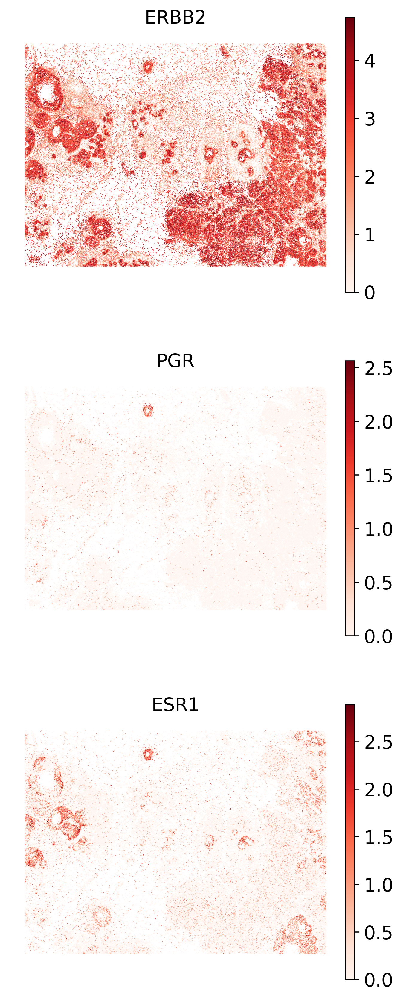

In [9]:
sc.pl.spatial(adata1, color=['ERBB2','PGR','ESR1'], ncols=1, spot_size=15, color_map='Reds', legend_fontsize='small', frameon=False)

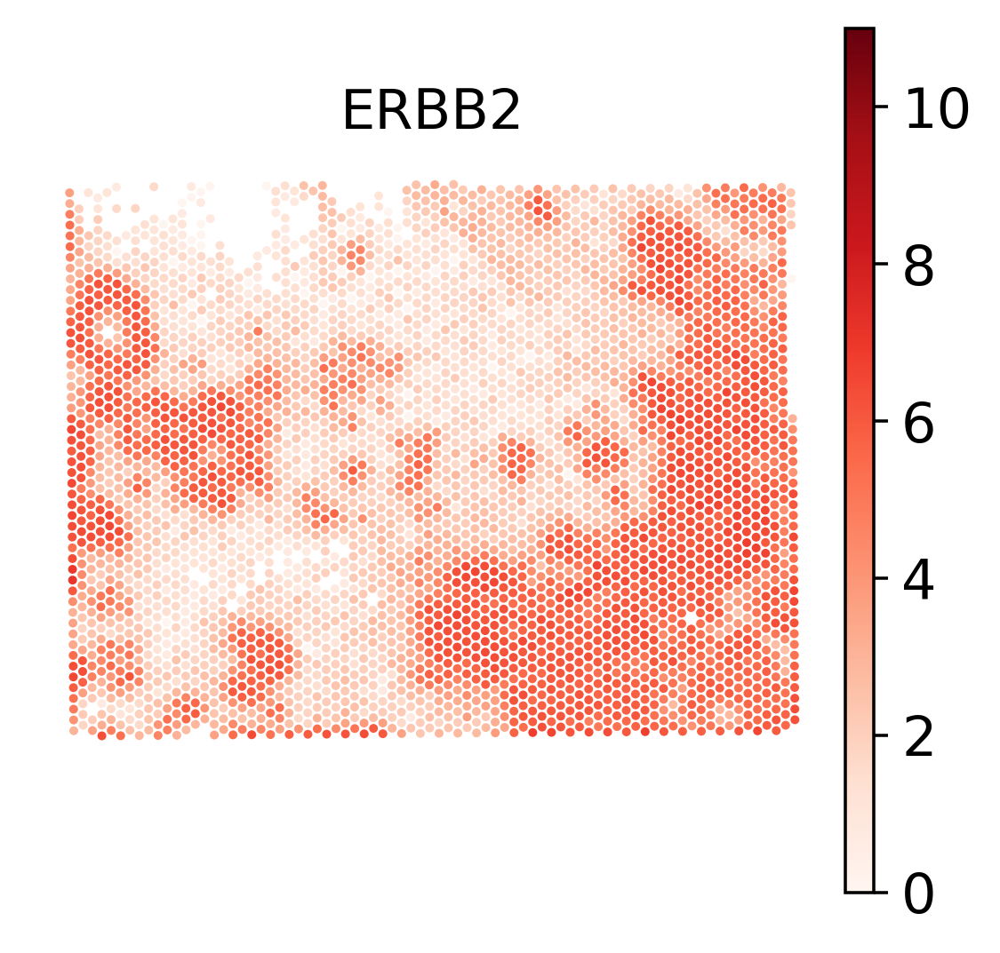

In [10]:
sc.pl.spatial(adata2, color=['ERBB2'], ncols=1, spot_size=150, color_map='Reds', legend_fontsize='small', vmin=0, vmax=11, frameon=False)

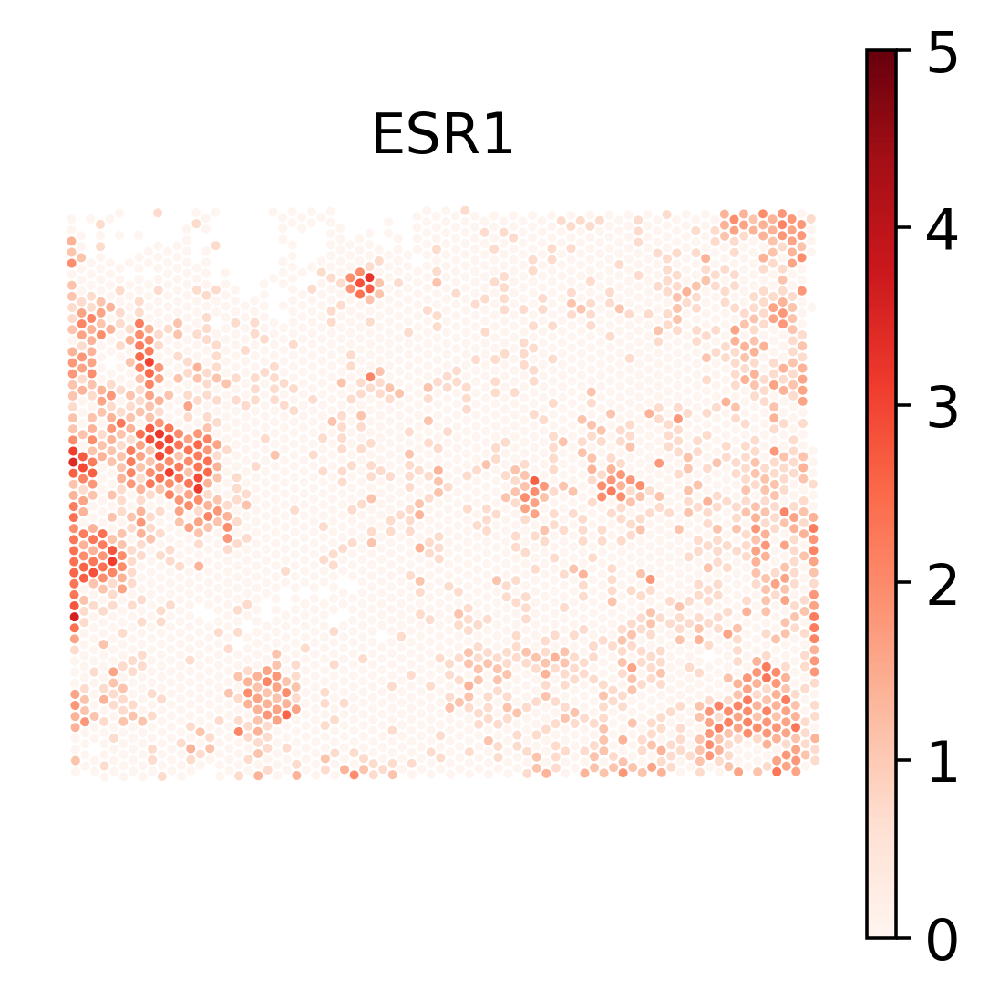

In [11]:
sc.pl.spatial(adata2, color=['ESR1'], ncols=1, spot_size=150, color_map='Reds', legend_fontsize='small', vmin=0, vmax=5, frameon=False)

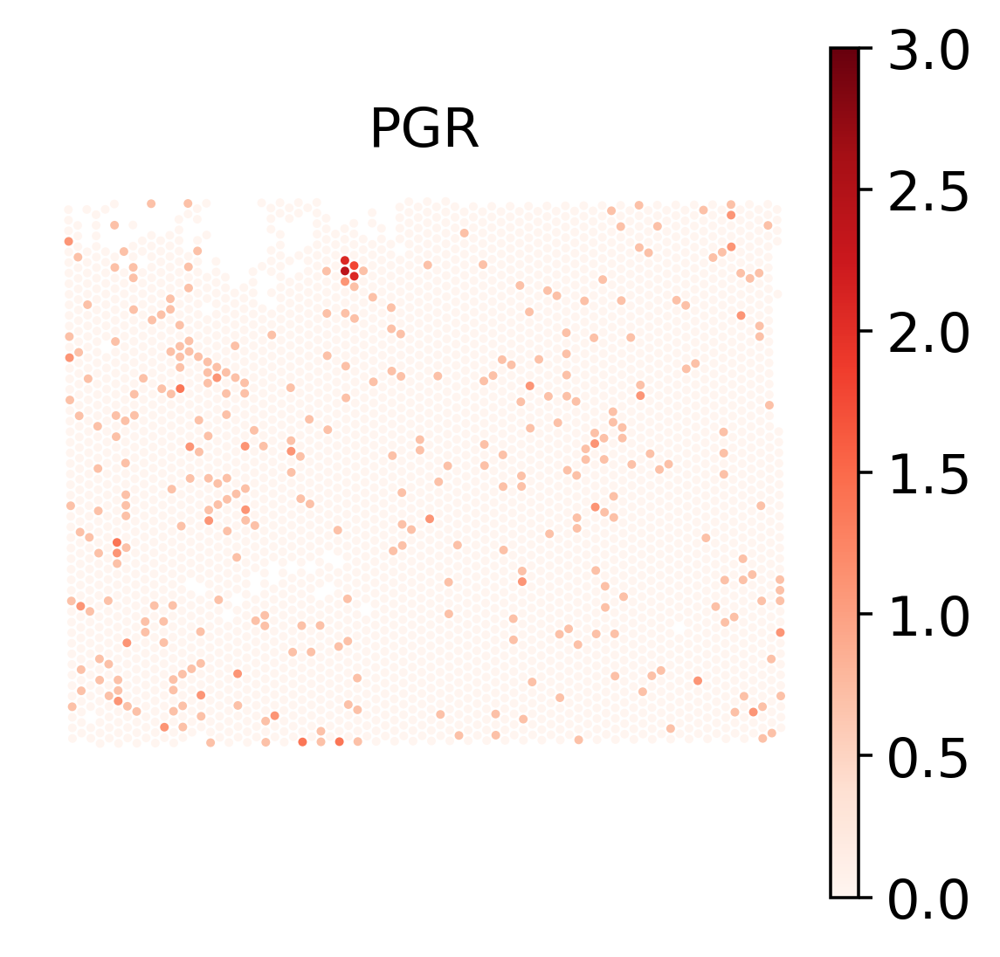

In [12]:
sc.pl.spatial(adata2, color=['PGR'], ncols=1, spot_size=150, color_map='Reds', legend_fontsize='small', vmin=0, vmax=3, frameon=False)

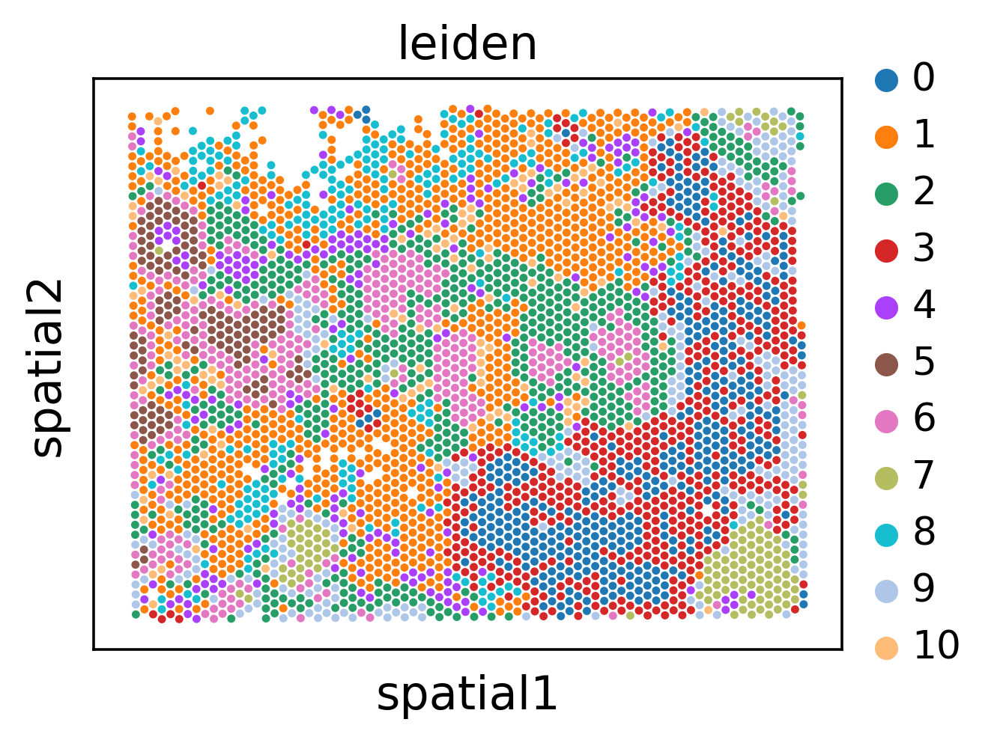

In [13]:
sc.pl.spatial(adata2, color=['leiden'], ncols=1, spot_size=150, color_map='Reds', legend_fontsize='small')

In [15]:
Cal_Spatial_Net(adata1, k_cutoff=120, model='KNN')
Cal_Spatial_Net(adata2, k_cutoff=5, model='KNN')

Calculating spatial neighbor graph ...
The graph contains 13226912 edges, 100642 cells.
131.4253691301842 neighbors per cell on average.
Calculating spatial neighbor graph ...
The graph contains 20683 edges, 3841 cells.
5.384795626139026 neighbors per cell on average.


In [16]:
edges, features = load_anndatas([adata1, adata2], feature='DPCA')
embd0, embd1, time = run_SLAT(features, edges, LGCN_layer=6, hidden_size=4096)

Use DPCA feature to format graph


/rd2/user/xiacr/SLAT/conda/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/rd2/user/xiacr/SLAT/conda/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(
/rd2/user/xiacr/SLAT/conda/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/rd2/user/xiacr/SLAT/conda/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/rd2/user/xiacr/SLAT/conda

Warning! Dual PCA is using GPU, which may lead to OUT OF GPU MEMORY in big dataset!
Choose GPU:3 as device
Running
---------- epochs: 1 ----------
---------- epochs: 2 ----------
---------- epochs: 3 ----------
---------- epochs: 4 ----------
---------- epochs: 5 ----------
---------- epochs: 6 ----------
Training model time: 8.90


In [26]:
best, index, distance = spatial_match(features, adatas=[adata1,adata2], reorder=False, top_n=200, smooth_range=200)

In [27]:
adata1_df = pd.DataFrame({'index':range(embd0.shape[0]),
                        'x': adata1.obsm['spatial'][:,0],
                        'y': adata1.obsm['spatial'][:,1],
                        'leiden':adata1.obs['leiden']})
adata2_df = pd.DataFrame({'index':range(embd1.shape[0]),
                        'x': adata2.obsm['spatial'][:,0],
                        'y': adata2.obsm['spatial'][:,1],
                        'leiden':adata2.obs['leiden']})

matching = np.array([range(index.shape[0]), best])
best_match = distance[:,0]

0.500~0.550        12          0.312%
0.550~0.600       102          2.656%
0.600~0.650       232          6.040%
0.650~0.700       432         11.247%
0.700~0.750       736         19.162%
0.750~0.800       801         20.854%
0.800~0.850       706         18.381%
0.850~0.900       575         14.970%
0.900~0.950       243          6.326%
0.950~1.000         0          0.000%


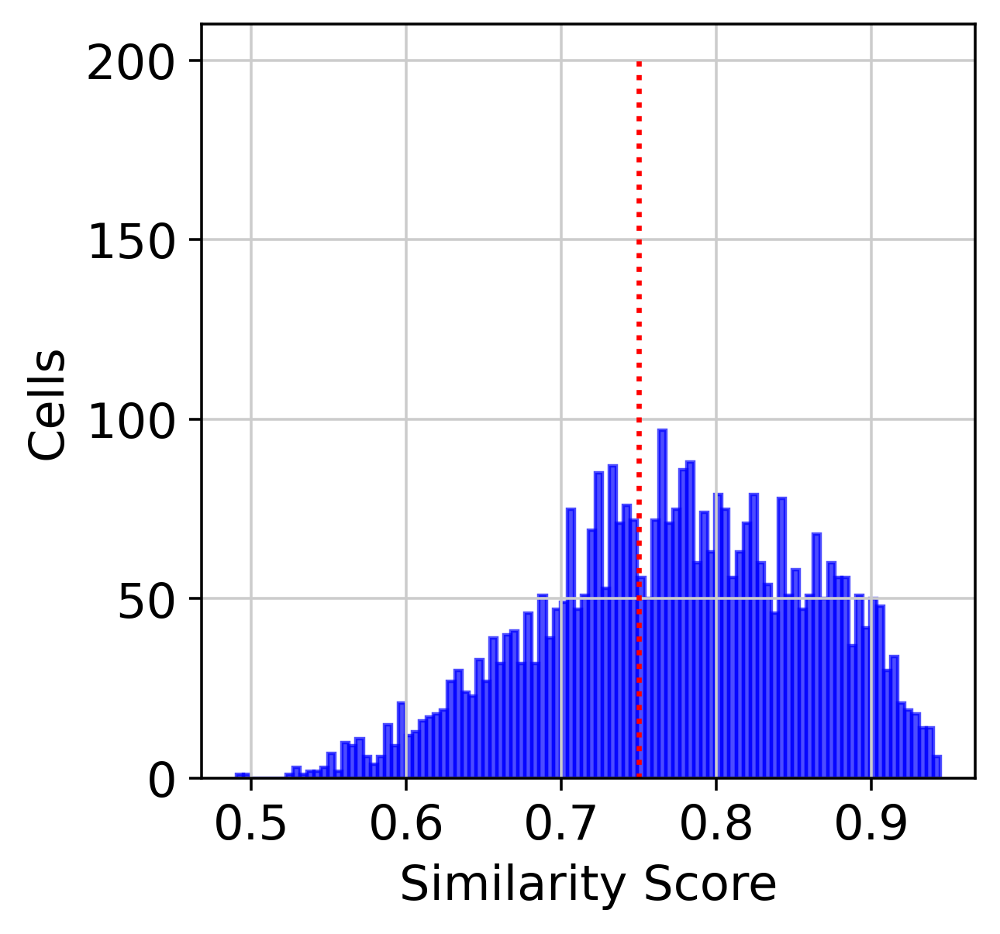

In [28]:
region_statistics(best_match,start=0.5,number_of_interval=10)
hist(best_match, cut=0.75)

# Subset

In [290]:
TP_barcode = pd.read_csv('../../data/visium/breast/TP.csv')
barcode2index = dict(zip(adata2.obs_names, range(adata2.shape[0])))
TP_index = TP_barcode['Barcode'].map(barcode2index).dropna()
TP_index = [int(i) for i in TP_index]

In [291]:
adata2.obs['TP_anno'] = 'No'
adata2.obs.loc[adata2.obs_names.isin(TP_barcode['Barcode']), 'TP_anno'] = 'Yes'

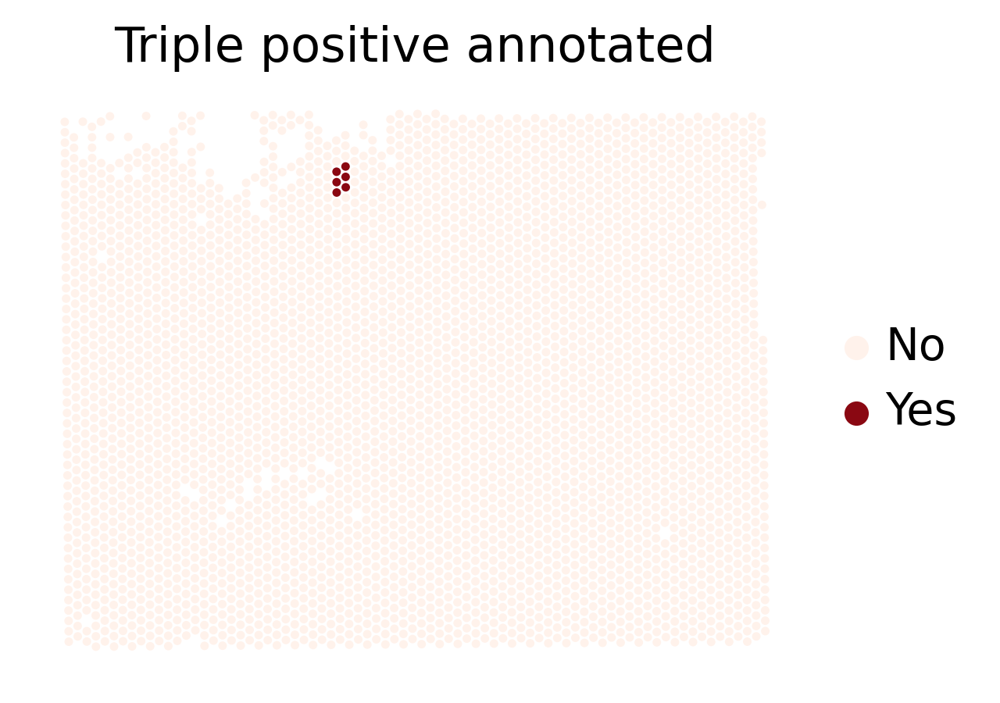

In [292]:
sc.pl.spatial(adata2, color='TP_anno', spot_size=150, title='Triple positive annotated', palette=['#fff2eb','#8A0812'], frameon=False)

In [101]:
TP_Xenium_coord = pd.read_csv('../../data/xenium/breast/TP_coordinates.csv')
tmp = sc.read_h5ad('../../data/xenium/breast/data1_split.h5ad')

In [102]:
ref_coord = tmp.obsm['spatial'].astype('float32').copy()

In [103]:
query_coord = TP_Xenium_coord.iloc[:,1:].to_numpy() * -1
query_coord = query_coord.astype('float32').copy()

In [106]:
index = faiss.IndexFlatL2(2) 
index.add(ref_coord)   
distance, order = index.search(query_coord, 2)

In [157]:
TP_Xenium_barcode = adata1.obs_names[order[:,0]]
TP_Xenium_index = list(set(order[:,0]))

In [232]:
adata1.obs['TP'] = 'No'
adata1.obs.loc[adata1.obs_names.isin(TP_Xenium_barcode) ,['TP']] = 'Yes'

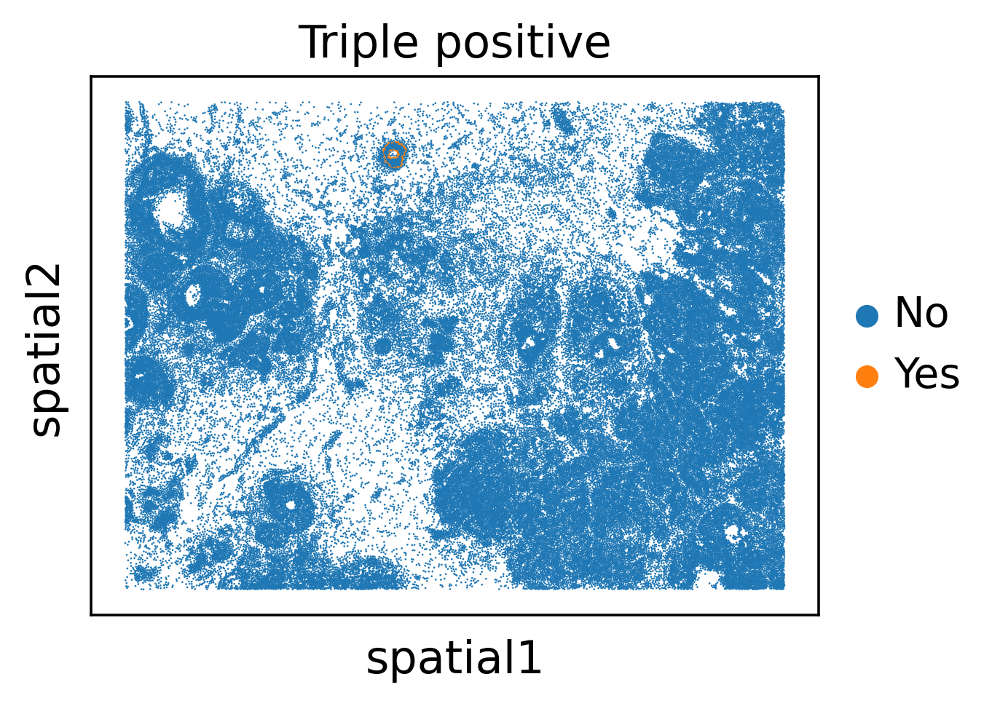

In [120]:
sc.pl.spatial(adata1,color='TP', spot_size=20, title='Triple positive')

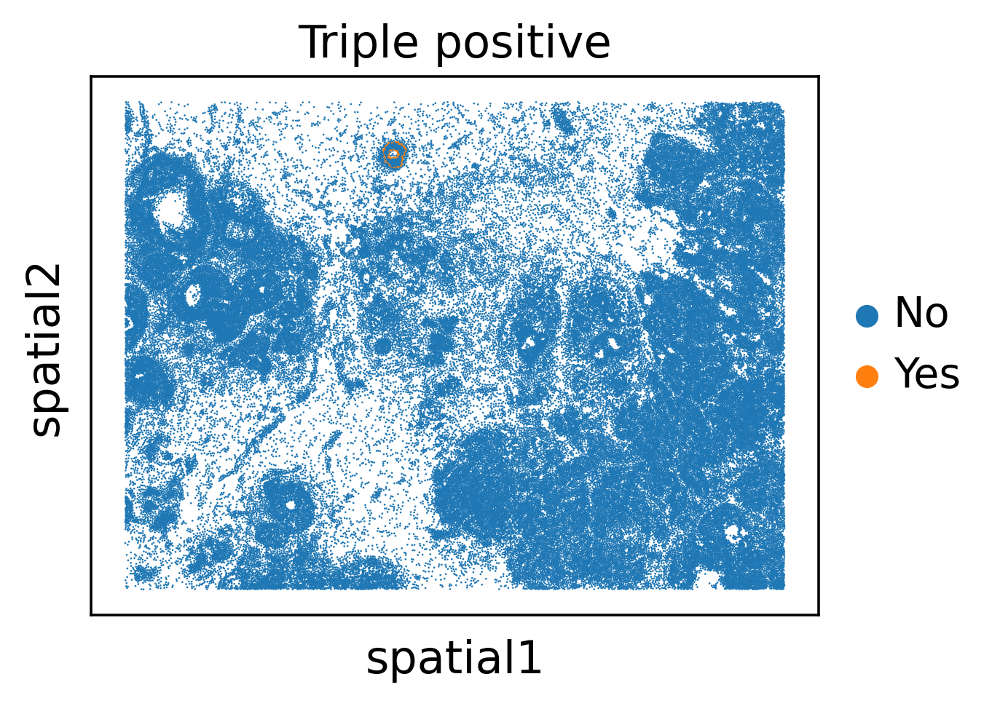

In [120]:
sc.pl.spatial(adata1,color='TP', spot_size=20, title='Triple positive')

In [147]:
best, index, distance = spatial_match(features[::-1], adatas=[adata2,adata1], reorder=False, top_n=50, smooth_range=50)

(100642, 50)


In [132]:
adata1_df = pd.DataFrame({'index':range(embd0.shape[0]),
                        'x': adata1.obsm['spatial'][:,0],
                        'y': adata1.obsm['spatial'][:,1],
                        'leiden':adata1.obs['leiden']})
adata2_df = pd.DataFrame({'index':range(embd1.shape[0]),
                        'x': adata2.obsm['spatial'][:,0],
                        'y': adata2.obsm['spatial'][:,1],
                        'leiden':adata2.obs['leiden']})

matching = np.array([range(index.shape[0]), best])
best_match = distance[:,0]

0.500~0.550      1087          1.080%
0.550~0.600      3144          3.124%
0.600~0.650      7543          7.495%
0.650~0.700     14249         14.158%
0.700~0.750     19530         19.405%
0.750~0.800     19564         19.439%
0.800~0.850     17682         17.569%
0.850~0.900     15003         14.907%
0.900~0.950      2548          2.532%
0.950~1.000         0          0.000%


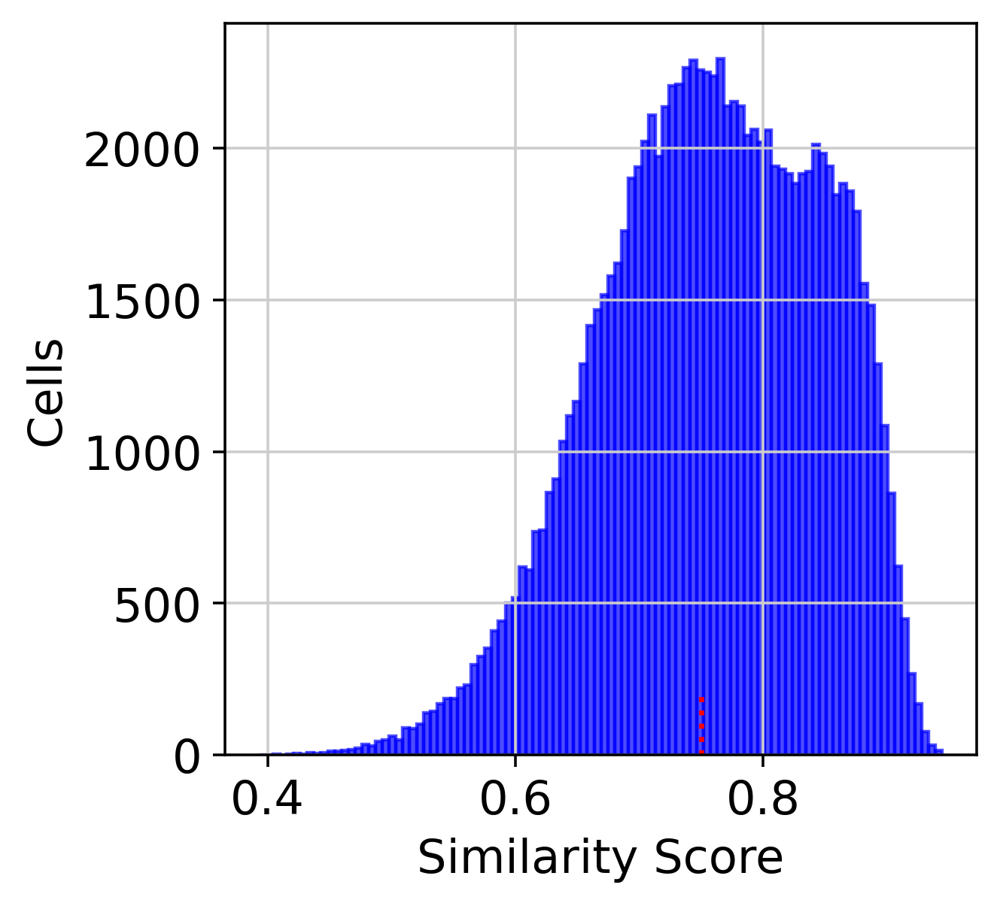

In [146]:
region_statistics(best_match,start=0.5,number_of_interval=10)
hist(best_match, cut=0.75)

In [158]:
TP_matching = matching[:,TP_Xenium_index]

In [163]:
unique_elements, frequency = np.unique(TP_matching[1,:], return_counts=True)
sorted_indexes = np.argsort(frequency)[::-1]
sorted_by_freq = unique_elements[sorted_indexes]

In [166]:
set(TP_index) & set(sorted_by_freq)

{182, 1389, 2611, 3615, 3672}

In [168]:
TP_index

[182, 1389, 2611, 3615, 3672, 3704]

In [167]:
sorted_by_freq

array([ 182, 2742, 3615, 1389, 1002, 3672, 2611, 2561, 2788, 3085,  183,
        578,  587,  778,  890, 1014, 2340, 1033, 1362, 1740, 1752, 1770,
       2141,  121])

In [175]:
np.sort(frequency)[::-1]

array([27, 12, 10,  9,  8,  5,  5,  2,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1])

/rd2/user/xiacr/SLAT/scSLAT/viz/multi_dataset.py:242: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.celltypes = set(self.dataset_A[meta].append(self.dataset_B[meta]))


dataset1: 11 cell types; dataset2: 11 cell types; 
                    Total :11 celltypes; Overlap: 11 cell types 
                    Not overlap :[[]]
Subsample 300 cell pairs from 100642


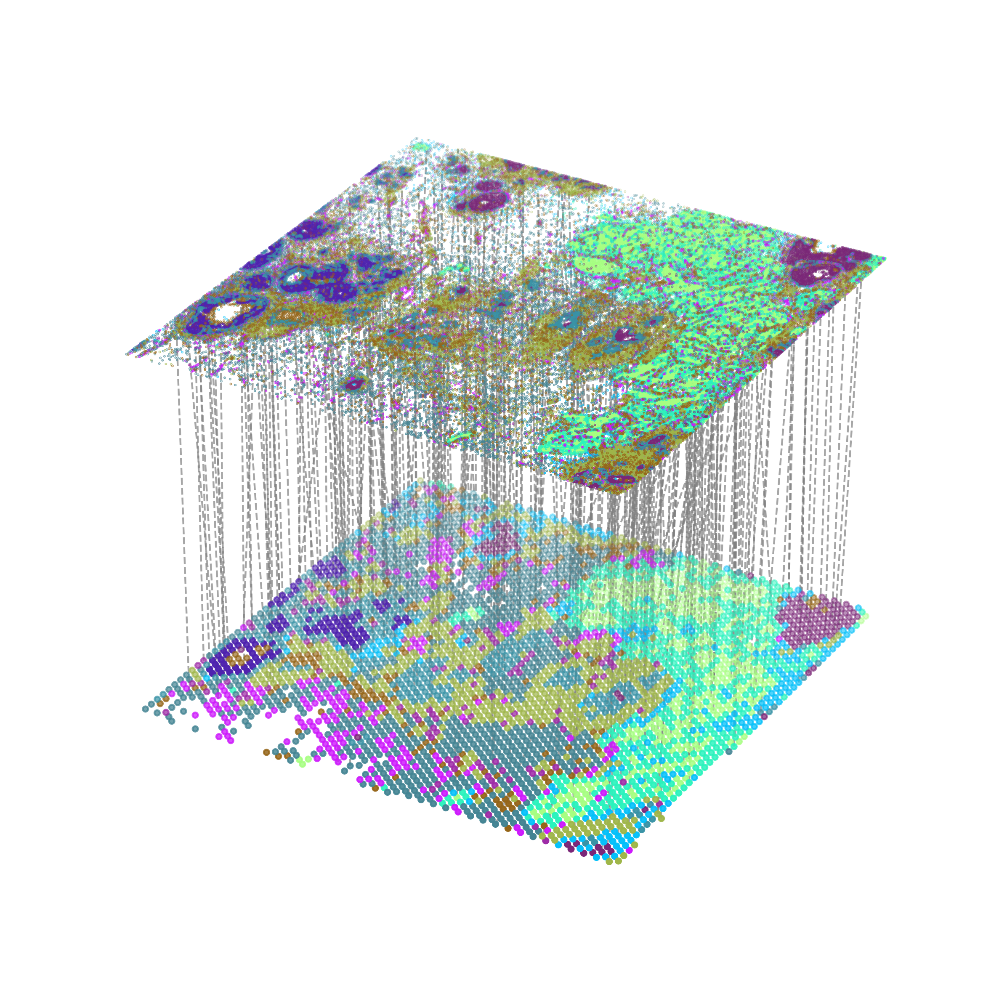

In [324]:
multi_align = match_3D_multi(adata2_df, adata1_df, matching, meta='leiden',
                            scale_coordinate=True, subsample_size=300)

multi_align.draw_3D(size=[13, 9.5], line_width=1 ,point_size=[8,0.1], show_error=False, hide_axis=True)

/rd2/user/xiacr/SLAT/scSLAT/viz/multi_dataset.py:242: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.celltypes = set(self.dataset_A[meta].append(self.dataset_B[meta]))


dataset1: 11 cell types; dataset2: 11 cell types; 
                    Total :11 celltypes; Overlap: 11 cell types 
                    Not overlap :[[]]
Subsample 10 cell pairs from 94


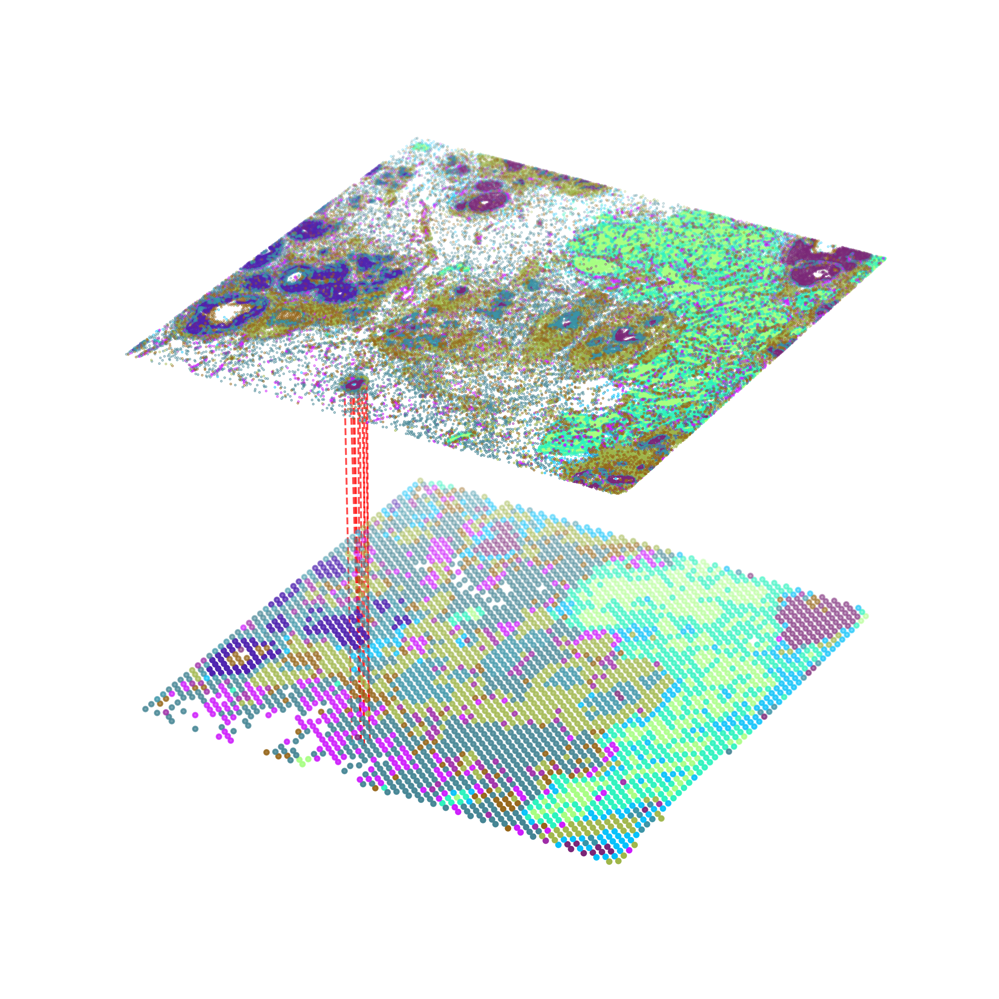

In [330]:
multi_align = match_3D_multi(adata2_df, adata1_df, matching,meta='leiden',
                            scale_coordinate=True, subsample_size=10, subset=list(set(order[:,0])))

multi_align.draw_3D(size=[13, 9.5], line_width=1 ,point_size=[6,0.1], show_error=False, hide_axis=True, line_color='red')

In [181]:
adata2.obs['TP_score'] = 0
for target, score in zip(sorted_by_freq ,np.sort(frequency)[::-1]):
    adata2.obs.iloc[target,:]['TP_score'] = score
    

/tmp/ipykernel_3136050/1822742753.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata2.obs.iloc[target,:]['TP_score'] = score


In [190]:
adata2.obs.iloc[sorted_by_freq, -1] = np.sort(frequency)[::-1]

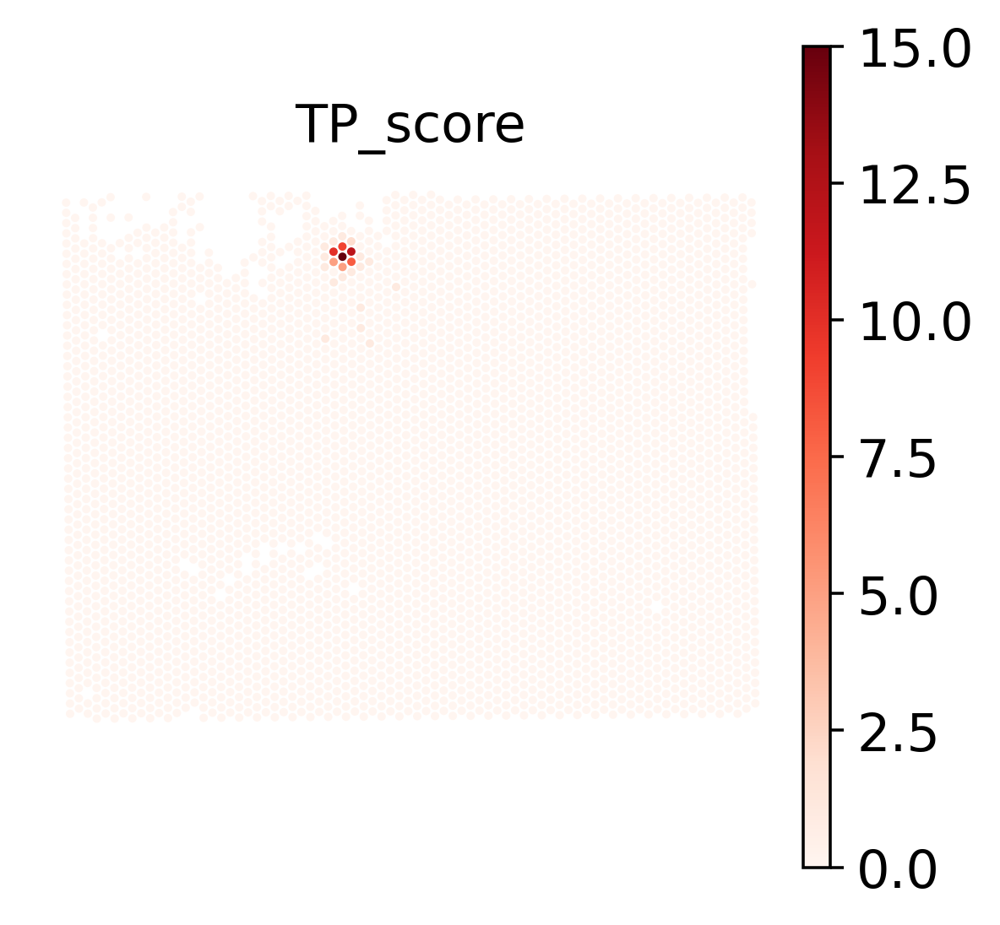

In [209]:
sc.pl.spatial(adata2, color='TP_score', spot_size=150, cmap='Reds', vmax=15, frameon=False)

In [217]:
adata1_df['PGR'] = sc.get.obs_df(adata1, 'PGR').values
adata2_df['PGR'] = sc.get.obs_df(adata2, 'PGR').values

/rd2/user/xiacr/SLAT/scSLAT/viz/multi_dataset.py:242: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.celltypes = set(self.dataset_A[meta].append(self.dataset_B[meta]))


dataset1: 11 cell types; dataset2: 11 cell types; 
                    Total :11 celltypes; Overlap: 11 cell types 
                    Not overlap :[[]]
Subsample 10 cell pairs from 94


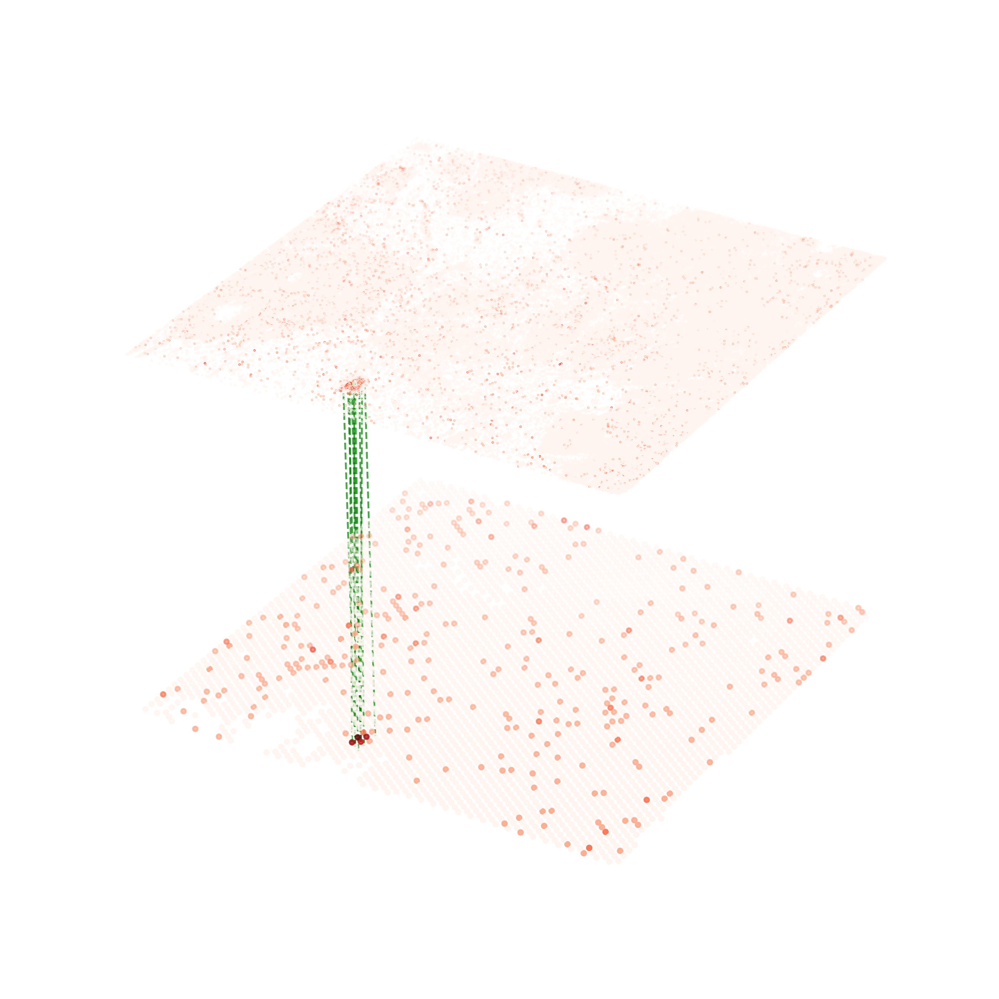

In [337]:
multi_align = match_3D_multi(adata2_df, adata1_df, matching, meta='leiden', expr='PGR',
                            scale_coordinate=True, subsample_size=10, subset=list(set(order[:,0])))

multi_align.draw_3D(size=[13, 9.5], line_width=1 ,point_size=[6, 0.1], show_error=False, hide_axis=True, line_color='green')

# DEGs

In [111]:
adata_raw = sc.read_h5ad('../../data/visium/breast/data3.h5ad')
adata2 = sc.read_h5ad('../../data/visium/breast/data3_split.h5ad')

In [112]:
adata_raw = adata_raw[list(adata2.obs_names)]

In [113]:
sorted_by_freq_filter = [182, 2742, 3615, 1389, 1002, 3672, 2611]

In [226]:
# sorted_by_freq_filter = sorted_by_freq[:7]

In [114]:
TP_align_barcode = adata_raw.obs.index[sorted_by_freq_filter]

In [115]:
adata_raw.obs['TP_align'] = 'No'
adata_raw.obs.loc[adata_raw.obs.index.isin(TP_align_barcode), 'TP_align'] = 'Yes'

/tmp/ipykernel_1097527/343851816.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_raw.obs['TP_align'] = 'No'


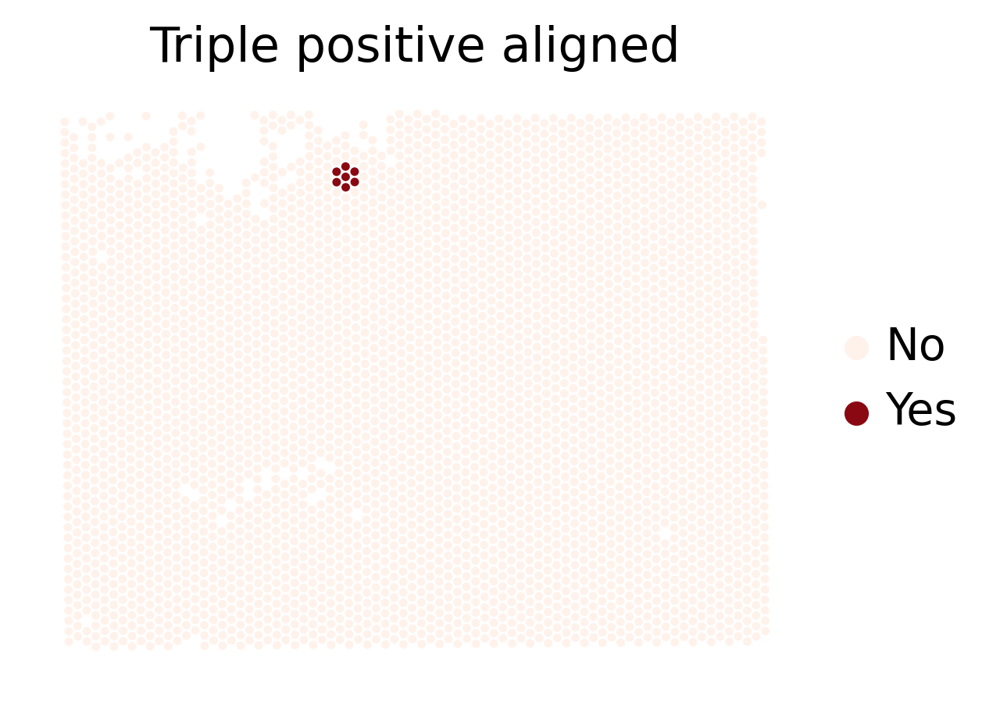

In [116]:
sc.pl.spatial(adata_raw, color='TP_align', spot_size=150, title='Triple positive aligned', palette=['#fff2eb','#8A0812'], frameon=False)

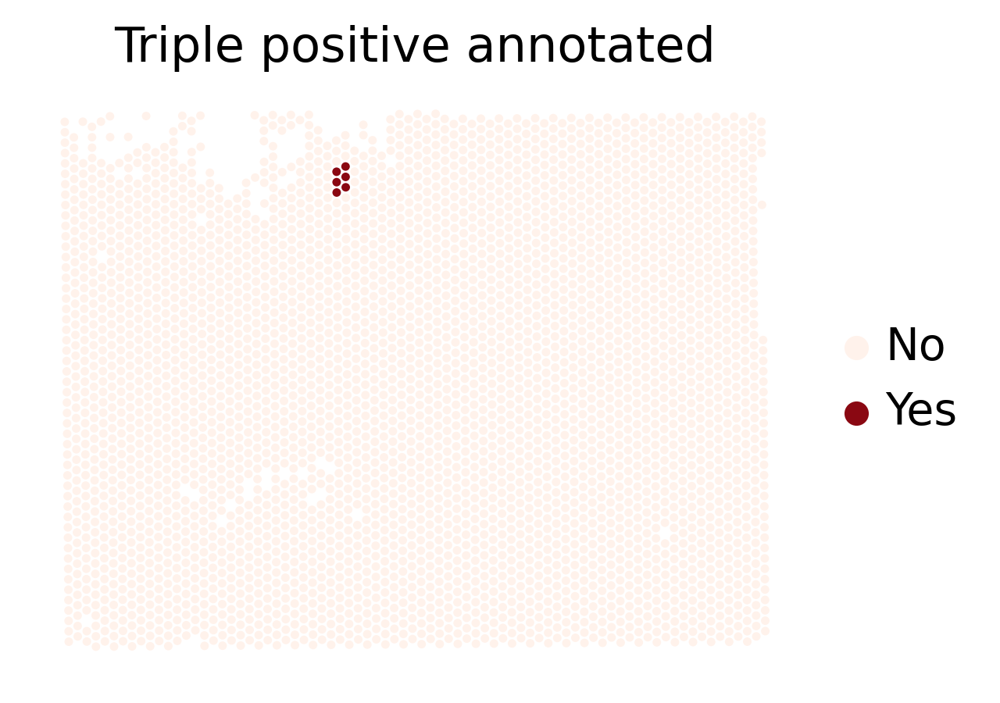

In [117]:
TP_barcode = pd.read_csv('../../data/visium/breast/TP.csv')
barcode2index = dict(zip(adata_raw.obs_names, range(adata_raw.shape[0])))
TP_index = TP_barcode['Barcode'].map(barcode2index).dropna()
TP_index = [int(i) for i in TP_index]
adata_raw.obs['TP_anno'] = 'No'
adata_raw.obs.loc[adata_raw.obs_names.isin(TP_barcode['Barcode']), 'TP_anno'] = 'Yes'
sc.pl.spatial(adata_raw, color='TP_anno', spot_size=150, title='Triple positive annotated', palette=['#fff2eb','#8A0812'], frameon=False)

In [118]:
# adata_raw = scanpy_workflow(adata_raw)
sc.pp.normalize_total(adata_raw, target_sum=1e4)
sc.pp.log1p(adata_raw)

In [120]:
adata_raw.X[1:5,1:6].todense()

matrix([[0.65224725, 0.        , 0.26744118, 0.        , 0.65224725],
        [0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.9138378 ],
        [0.        , 0.3297752 , 0.        , 0.        , 0.        ]],
       dtype=float32)

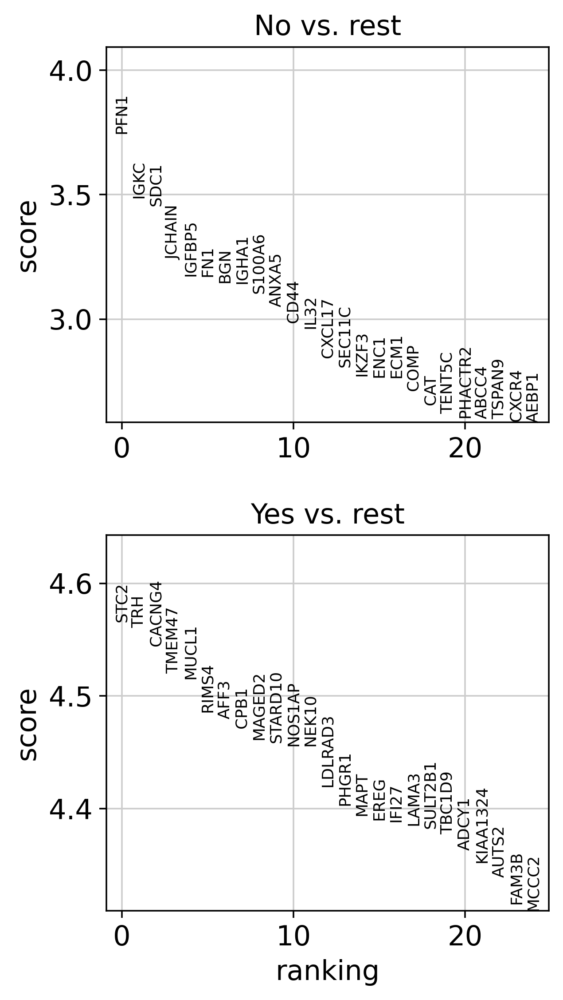

In [148]:
sc.tl.rank_genes_groups(adata_raw, 'TP_align', method='wilcoxon')
sc.pl.rank_genes_groups(adata_raw, n_genes=25, sharey=False, ncols=1)
result = adata_raw.uns['rank_genes_groups']
groups = result['names'].dtype.names
marker_TP_align = pd.DataFrame(
    {group + '_' + key[:4]: result[key][group]
    for group in groups for key in ['names', 'pvals','logfoldchanges','scores']}).head(25)

In [136]:
hvg = pd.DataFrame(
    {group + '_' + key[:4]: result[key][group]
    for group in groups for key in ['names', 'pvals','logfoldchanges','scores']})
hvg_sig = hvg.loc[(hvg.Yes_pval<0.05) & (hvg.Yes_logf>1.5), :]
hvg_sig.shape

(570, 8)

In [139]:
hvg.to_csv('../../data/visium/breast/hvg_align.csv')

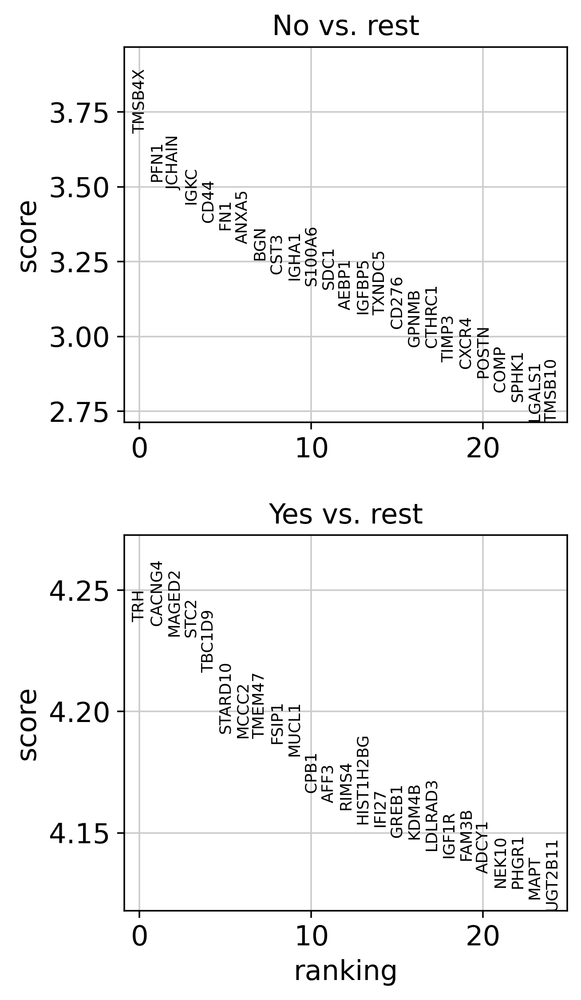

In [149]:
sc.tl.rank_genes_groups(adata_raw, 'TP_anno', method='wilcoxon')
sc.pl.rank_genes_groups(adata_raw, n_genes=25, sharey=False, ncols=1)
result = adata_raw.uns['rank_genes_groups']
groups = result['names'].dtype.names
marker_TP_anno = pd.DataFrame(
    {group + '_' + key[:4]: result[key][group]
    for group in groups for key in ['names', 'pvals','logfoldchanges','scores']}).head(25)

In [150]:
len(set(marker_TP_anno.Yes_name) & set(marker_TP_align.Yes_name))

19

In [153]:
set(marker_TP_align.Yes_name) - set(marker_TP_anno.Yes_name)

{'AUTS2', 'EREG', 'KIAA1324', 'LAMA3', 'NOS1AP', 'SULT2B1'}

In [151]:
len(set(marker_TP_anno.Yes_name) | set(marker_TP_align.Yes_name))

31

In [128]:
share_genes = list(set(marker_TP_anno.Yes_name) & set(marker_TP_align.Yes_name))

In [129]:
marker_TP_anno_logFC = marker_TP_anno.loc[marker_TP_anno.Yes_name.isin(share_genes),['Yes_name','Yes_logf']]
marker_TP_align_logFC = marker_TP_align.loc[marker_TP_align.Yes_name.isin(share_genes),['Yes_name','Yes_logf']]

In [130]:
marker_merge_logFC = marker_TP_anno_logFC.merge(marker_TP_align_logFC, on='Yes_name', how='left' )

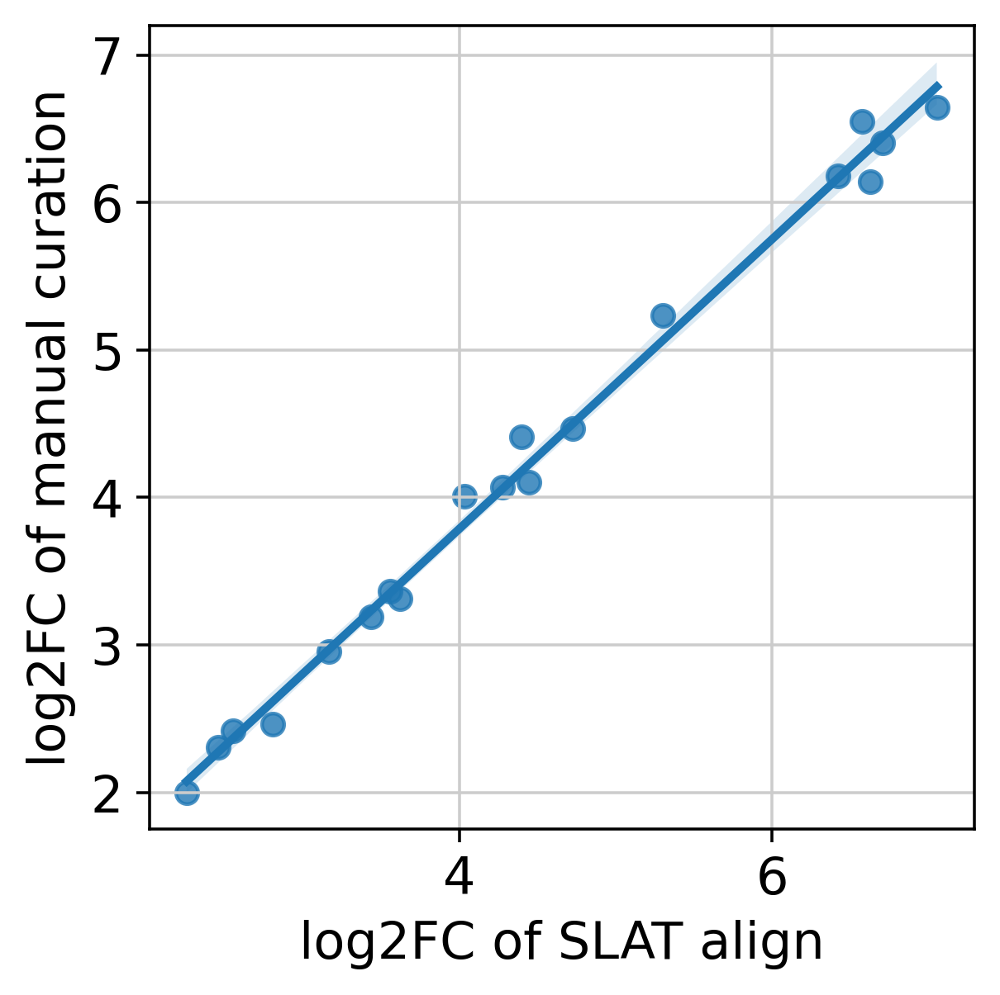

In [147]:
ax = sns.regplot(data=marker_merge_logFC, x="Yes_logf_x", y="Yes_logf_y",)
ax.set(xlabel='log2FC of SLAT align', ylabel='log2FC of manual curation')
plt.show()

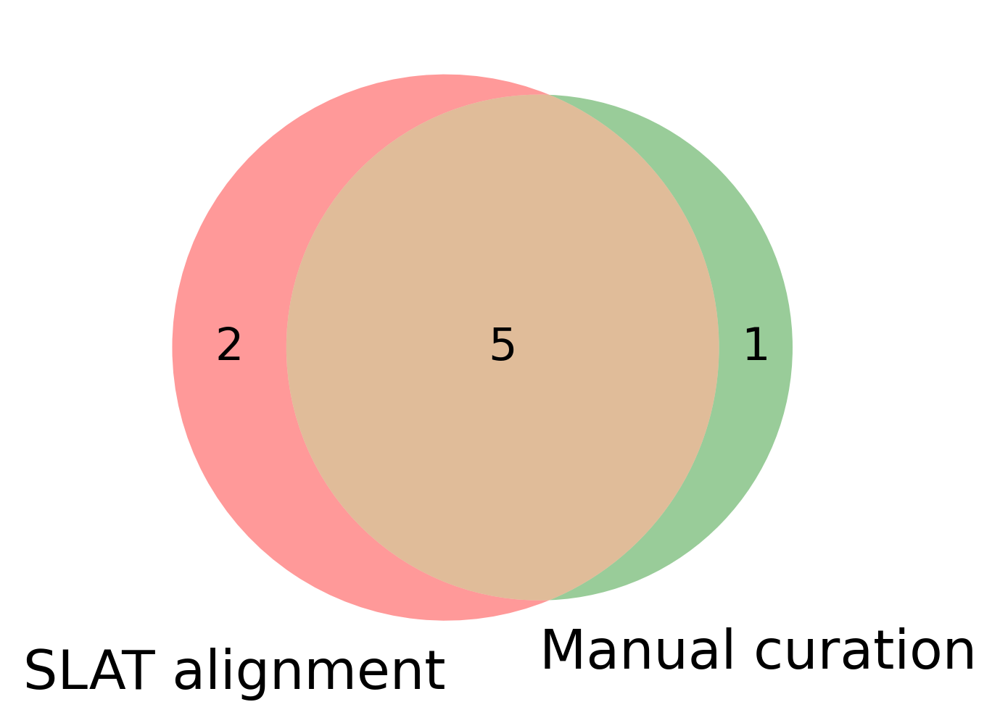

In [6]:
# Use the venn2 function
venn2(subsets = (2, 1, 5), set_labels = ('SLAT alignment', 'Manual curation'))
plt.show()

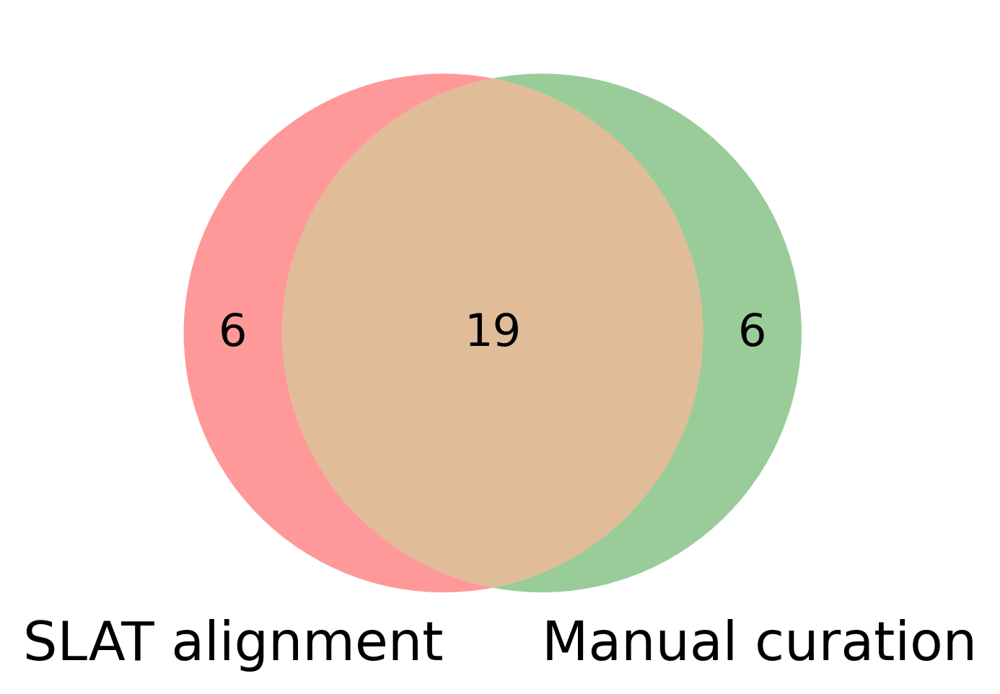

In [132]:
# Use the venn2 function
venn2(subsets = (6, 6, 19), set_labels = ('SLAT alignment', 'Manual curation'))
plt.show()

In [158]:
adata2.obs

,batch,nCount_RNA,nFeature_RNA,leiden
AACACGTGCATCGCAC-1,visium,296.0,112,1
AACACTTGGCAAGGAA-1,visium,1231.0,202,6
AACAGGAAGAGCATAG-1,visium,301.0,133,4
AACAGGATTCATAGTT-1,visium,285.0,98,1
AACAGGTTATTGCACC-1,visium,949.0,164,10
...,...,...,...,...
TGTTGGAACCTTCCGC-1,visium,339.0,90,1
TGTTGGAACGAGGTCA-1,visium,479.0,117,1
TGTTGGAAGCTCGGTA-1,visium,1240.0,220,9
TGTTGGATGGACTTCT-1,visium,1753.0,196,3
